# Análise e ETL — Acidentes de Trânsito (Fortaleza)

Este notebook faz:

1. **Carga e inspeção inicial (EDA)**  
2. **ETL**: limpeza/padronização de campos (geográficos, horário etc.)  
3. **Visualizações**: mapas (heatmap/cluster) e gráficos de contagem/soma

> **Obs.** Ajuste o caminho do arquivo CSV na célula de leitura, conforme o local onde você salvou o dataset.


In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import folium
from folium.plugins import HeatMap, MarkerCluster


In [2]:
# ===== 1) CARGA DOS DADOS =====
# Ajuste o caminho do arquivo para o seu ambiente
CSV_PATH = "/home/vitormuniz/Documentos/data/acidentes/cat_acidentes.csv"

data = pd.read_csv(CSV_PATH, sep=";")
data.head()


,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-09-01 01:33:25,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-09-01 01:33:25,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-09-01 01:33:25,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-09-01 01:33:25,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-09-01 01:33:25,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN


In [3]:
# ===== 2) INSPEÇÃO INICIAL (EDA) =====
data.info()


<class 'pandas.DataFrame'>
RangeIndex: 75176 entries, 0 to 75175
Data columns (total 34 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   data_extracao  75176 non-null  str    
 1   predial1       70715 non-null  float64
 2   queda_arr      75176 non-null  float64
 3   data           75176 non-null  str    
 4   feridos        75176 non-null  int64  
 5   feridos_gr     75176 non-null  int64  
 6   mortes         75176 non-null  int64  
 7   morte_post     75176 non-null  int64  
 8   fatais         75176 non-null  int64  
 9   auto           75176 non-null  int64  
 10  taxi           75176 non-null  int64  
 11  lotacao        75176 non-null  int64  
 12  onibus_urb     75176 non-null  int64  
 13  onibus_met     75176 non-null  int64  
 14  onibus_int     75176 non-null  int64  
 15  caminhao       75176 non-null  int64  
 16  moto           75176 non-null  int64  
 17  carroca        75176 non-null  int64  
 18  bicicleta      75

In [4]:
data.describe(include='all')

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
count,75176,7.071500e+04,75176.000000,75176,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,...,64580.000000,64580.000000,75123,20653,75176,75176,74547,75176,75175,2410
unique,1,NaN,NaN,2065,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,3903,2063,10,7,1391,2,4,20
top,2025-09-01 01:33:25,NaN,NaN,2025-05-28 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,AV PROTASIO ALVES,AV IPIRANGA,ABALROAMENTO,SEXTA-FEIRA,18:00:00.0000000,DIA,LESTE,CARRIS
freq,75176,NaN,NaN,87,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,2789,541,31180,12780,1219,52967,23937,649
mean,NaN,1.761212e+03,0.000372,NaN,0.445435,0.077538,0.003086,0.002714,0.005800,1.436057,...,-50.725793,-29.779233,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,6.618613e+03,0.019296,NaN,0.659939,0.290935,0.058045,0.052531,0.079194,0.759471,...,4.816518,2.827850,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,0.000000e+00,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-51.265854,-30.242610,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,2.000000e+02,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,...,-51.212701,-30.065245,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,7.770000e+02,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,...,-51.189427,-30.037994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,2.205000e+03,0.000000,NaN,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,...,-51.153935,-30.017000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
# Contagem de nulos por coluna
data.isnull().sum().sort_values(ascending=False)

consorcio        72766
log2             54523
latitude         10596
longitude        10596
predial1          4461
hora               629
log1                53
regiao               1
data_extracao        0
queda_arr            0
taxi                 0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
carroca              0
moto                 0
caminhao             0
onibus_int           0
onibus_met           0
onibus_urb           0
lotacao              0
bicicleta            0
patinete             0
idacidente           0
cont_vit             0
ups                  0
outro                0
tipo_acid            0
dia_sem              0
noite_dia            0
dtype: int64

## ETL — Ajustes geográficos (latitude/longitude)

### Regras aplicadas
- Valores **0** em latitude/longitude normalmente representam ausência de coordenada → convertemos para **NaN**.
- Preenchimento opcional usando chaves de logradouro (`log1` e `log2`):  
  se existe um registro do mesmo logradouro com coordenadas válidas, usamos esse par para preencher os faltantes.


In [6]:
# ===== 3) ETL GEOGRÁFICO =====

# 3.1) Tratar coordenadas 0 como "sem valor"
data["latitude"]  = data["latitude"].replace(0, np.nan)
data["longitude"] = data["longitude"].replace(0, np.nan)

# 3.2) Preencher coordenadas faltantes usando o logradouro 1 (log1)
mapa_rua_log1 = (
    data.dropna(subset=["log1", "latitude", "longitude"])
        .drop_duplicates(subset=["log1"])
        .set_index("log1")[["latitude", "longitude"]]
)

mask = data["latitude"].isna() | data["longitude"].isna()
data.loc[mask, "latitude"]  = data.loc[mask, "log1"].map(mapa_rua_log1["latitude"])
data.loc[mask, "longitude"] = data.loc[mask, "log1"].map(mapa_rua_log1["longitude"])

# 3.3) Preencher coordenadas faltantes usando o logradouro 2 (log2)
mapa_rua_log2 = (
    data.dropna(subset=["log2", "latitude", "longitude"])
        .drop_duplicates(subset=["log2"])
        .set_index("log2")[["latitude", "longitude"]]
)

mask = data["latitude"].isna() | data["longitude"].isna()

# ⚠️ Correção importante:
# Aqui o mapeamento deve usar a coluna "log2" (não "log1").
data.loc[mask, "latitude"]  = data.loc[mask, "log2"].map(mapa_rua_log2["latitude"])
data.loc[mask, "longitude"] = data.loc[mask, "log2"].map(mapa_rua_log2["longitude"])

# Conferência rápida
data[["latitude","longitude"]].isna().sum()


latitude     3845
longitude    3845
dtype: int64

In [7]:
# Remover registros sem coordenadas e sem região (não dá para mapear/analisar por região)
data = data.dropna(subset=["latitude", "longitude", "regiao"])

# Colunas auxiliares usadas só para preencher coordenadas (podem ser removidas após o ETL)
cols_to_drop = [c for c in ["log1", "log2", "predial1"] if c in data.columns]
data = data.drop(columns=cols_to_drop)

data.isnull().sum().sort_values(ascending=False).head(20)


consorcio        69061
hora               621
data_extracao        0
feridos              0
feridos_gr           0
queda_arr            0
data                 0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
mortes               0
morte_post           0
caminhao             0
onibus_int           0
moto                 0
carroca              0
cont_vit             0
dtype: int64

## ETL — Coluna `hora`

O dataset traz `hora` como string no formato `HH:MM:SS.fffffff`.  
Aqui fazemos:

1. Converter para datetime (apenas hora)  
2. Criar **inteiro arredondado** (ex.: 19:30 → 20) com dtype `Int64` (aceita nulos)  
3. Preencher valores faltantes com a média (arredondada) por período (`noite_dia`)

> Se `noite_dia` não existir no seu dataset, substitua pela coluna correta.


In [8]:
# ===== 4) ETL DA COLUNA HORA =====

# Ver linhas com hora nula (diagnóstico)
data_hora_null = data[data["hora"].isna()]
data_hora_null.head()


,data_extracao,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,taxi,...,patinete,idacidente,longitude,latitude,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
692,2025-09-01 01:33:25,0.0,2020-01-28 00:00:00,0,0,0,0,0,1,0,...,0,669888,-51.114792,-29.975967,CHOQUE,TERÇA-FEIRA,NaN,NOITE,NORTE,NaN
908,2025-09-01 01:33:25,0.0,2020-02-04 00:00:00,1,0,0,0,0,0,0,...,0,670108,-51.153991,-30.041495,CHOQUE,TERÇA-FEIRA,NaN,NOITE,LESTE,NaN
1832,2025-09-01 01:33:25,0.0,2020-02-13 00:00:00,0,0,0,0,0,2,0,...,0,671038,-51.170473,-29.988763,ABALROAMENTO,QUINTA-FEIRA,NaN,NOITE,NORTE,NaN
2000,2025-09-01 01:33:25,0.0,2020-03-07 00:00:00,1,0,0,0,0,0,1,...,0,671207,-51.232969,-30.038595,ABALROAMENTO,SÁBADO,NaN,NOITE,CENTRO,NaN
2876,2025-09-01 01:33:25,0.0,2020-04-20 00:00:00,3,0,0,0,0,1,0,...,0,672085,-51.226676,-30.079973,CHOQUE,SEGUNDA-FEIRA,NaN,NOITE,SUL,NaN


In [9]:
# Conferir valores do período (dia/noite) nas linhas com hora nula (se existir a coluna)
if "noite_dia" in data_hora_null.columns:
    data_hora_null["noite_dia"].unique()
else:
    print("Coluna 'noite_dia' não encontrada no dataset.")


In [10]:
# Converter 'hora' para inteiro (hora arredondada)
# - errors='coerce' transforma strings inválidas em NaT (equivalente a NaN)
dt = pd.to_datetime(data["hora"], format="%H:%M:%S.%f", errors="coerce")

data["hora_int"] = np.round(dt.dt.hour + dt.dt.minute / 60).astype("Int64")

# Se existir arredondamento para 24 (ex.: 23:40 → 24), trave no máximo 23
data["hora_int"] = data["hora_int"].clip(0, 23)

data[["hora", "hora_int"]].head(10)


,hora,hora_int
0,19:00:00.0000000,19
1,03:00:00.0000000,3
2,23:00:00.0000000,23
4,09:00:00.0000000,9
6,14:15:00.0000000,14
8,21:30:00.0000000,22
9,10:30:00.0000000,10
10,07:45:00.0000000,8
11,07:10:00.0000000,7
13,17:50:00.0000000,18


In [ ]:
# Preencher hora_int nula com média arredondada do período "NOITE" (se aplicável)
if "noite_dia" in data.columns:
    media_noite = data.loc[data["noite_dia"] == "NOITE", "hora_int"].mean()
    # media_noite já sai float; arredondamos e convertimos para int (mantendo Int64)
    media_noite_int = int(np.round(media_noite)) if pd.notna(media_noite) else None
    data["hora_int"] = data["hora_int"].fillna(media_noite_int)
else:
    # fallback: usar a média global se não houver coluna de período
    media_global_int = int(np.round(data["hora_int"].mean()))
    data["hora_int"] = data["hora_int"].fillna(media_global_int)

data["hora_int"].isna().sum()


np.int64(0)

## ETL — Coluna `consorcio`

Se a coluna não agrega valor para análise (ou está muito esparsa), pode ser removida.


In [12]:
# ===== 5) ETL CONSÓRCIO =====
if "consorcio" in data.columns:
    data = data.drop(columns=["consorcio"])

data.isnull().sum().sort_values(ascending=False).head(20)


hora             621
queda_arr          0
data_extracao      0
feridos            0
feridos_gr         0
mortes             0
data               0
fatais             0
auto               0
taxi               0
lotacao            0
onibus_urb         0
onibus_met         0
onibus_int         0
morte_post         0
caminhao           0
moto               0
bicicleta          0
carroca            0
cont_vit           0
dtype: int64

## Mapas (Heatmap e Cluster)

Os mapas são centralizados automaticamente na **média** das coordenadas do dataset.


In [13]:
# ===== 6) MAPA DE CALOR =====
center = [data["latitude"].mean(), data["longitude"].mean()]
mapa = folium.Map(location=center, zoom_start=11)

coordenadas = list(zip(data["latitude"], data["longitude"]))
HeatMap(coordenadas, radius=9, blur=10).add_to(mapa)

mapa


In [14]:
# ===== 7) MAPA COM CLUSTER =====
center = [data["latitude"].mean(), data["longitude"].mean()]
mapa = folium.Map(location=center, zoom_start=11)

coordenadas = list(zip(data["latitude"], data["longitude"]))
MarkerCluster(coordenadas).add_to(mapa)

mapa


## Análises rápidas

Gráficos simples para entender:
- Volume de registros por **dia da semana**
- Volume por **período** (`noite_dia`)
- Soma de mortes por **período** e por **dia da semana**


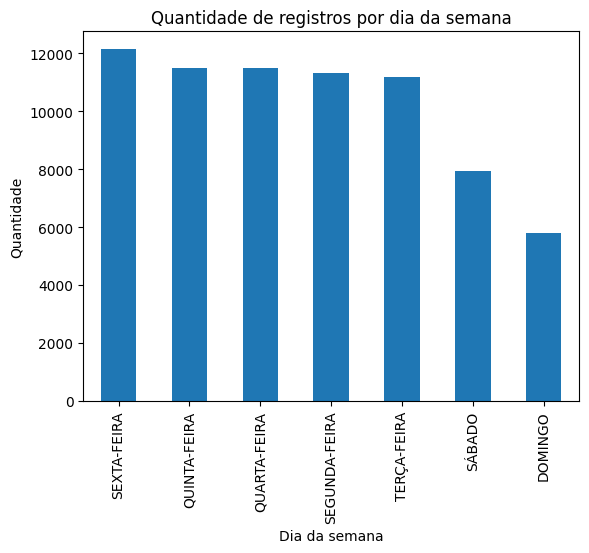

In [15]:
# ===== 8) Registros por dia da semana =====
contagem_dia_sem = data["dia_sem"].value_counts(dropna=False)

ax = contagem_dia_sem.plot(kind="bar")
ax.set_title("Quantidade de registros por dia da semana")
ax.set_xlabel("Dia da semana")
ax.set_ylabel("Quantidade")
plt.show()


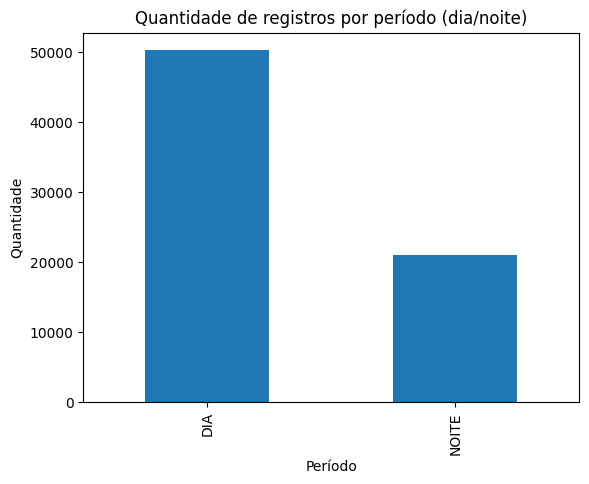

In [16]:
# ===== 9) Registros por período (dia/noite) =====
if "noite_dia" in data.columns:
    contagem_periodo = data["noite_dia"].value_counts(dropna=False)

    ax = contagem_periodo.plot(kind="bar")
    ax.set_title("Quantidade de registros por período (dia/noite)")
    ax.set_xlabel("Período")
    ax.set_ylabel("Quantidade")
    plt.show()
else:
    print("Coluna 'noite_dia' não encontrada no dataset.")


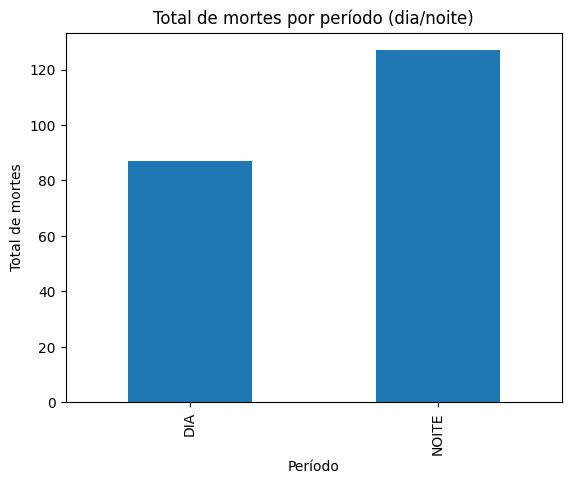

In [17]:
# ===== 10) Total de mortes por período (dia/noite) =====
if "noite_dia" in data.columns and "mortes" in data.columns:
    soma_mortes_periodo = data.groupby("noite_dia")["mortes"].sum()

    ax = soma_mortes_periodo.plot(kind="bar")
    ax.set_title("Total de mortes por período (dia/noite)")
    ax.set_xlabel("Período")
    ax.set_ylabel("Total de mortes")
    plt.show()
else:
    print("Colunas necessárias não encontradas: 'noite_dia' e/ou 'mortes'.")


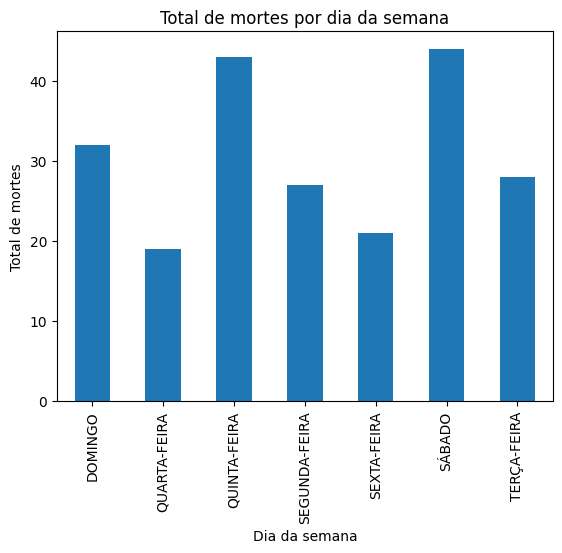

In [18]:
# ===== 11) Total de mortes por dia da semana =====
if "dia_sem" in data.columns and "mortes" in data.columns:
    soma_mortes_dia_sem = data.groupby("dia_sem")["mortes"].sum()

    ax = soma_mortes_dia_sem.plot(kind="bar")
    ax.set_title("Total de mortes por dia da semana")
    ax.set_xlabel("Dia da semana")
    ax.set_ylabel("Total de mortes")
    plt.show()
else:
    print("Colunas necessárias não encontradas: 'dia_sem' e/ou 'mortes'.")


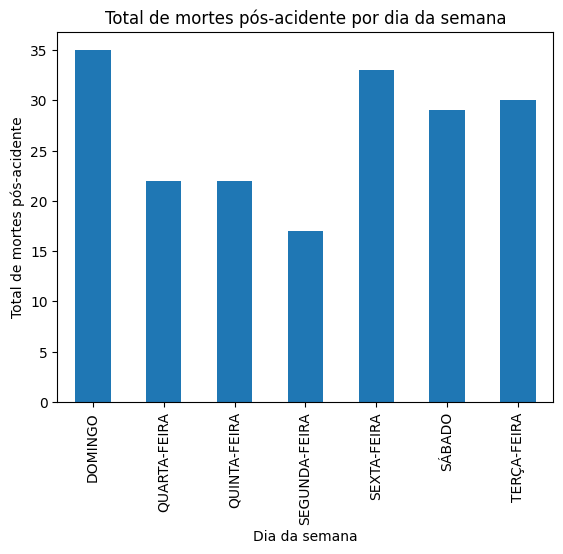

In [19]:
# ===== 12) Total de mortes pós-acidente por dia da semana (se existir) =====
if "dia_sem" in data.columns and "morte_post" in data.columns:
    soma_morte_post_dia_sem = data.groupby("dia_sem")["morte_post"].sum()

    ax = soma_morte_post_dia_sem.plot(kind="bar")
    ax.set_title("Total de mortes pós-acidente por dia da semana")
    ax.set_xlabel("Dia da semana")
    ax.set_ylabel("Total de mortes pós-acidente")
    plt.show()
else:
    print("Coluna 'morte_post' não encontrada (ou 'dia_sem' ausente).")
